In [3]:
#look for files in C:/Users/zacbe/Downloads/Janna/Datasets :
import os
import glob

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

from wordcloud import WordCloud

import plotly.express as px
import plotly.graph_objects as go
import plotly.graph_objs as go
from plotly.subplots import make_subplots


import dash
from dash import dcc, dash_table
from jupyter_dash import JupyterDash
import dash_html_components as html


from dash import html
import plotly.express as px


mapbox_access_token = 'pk.eyJ1IjoiemFjYmUiLCJhIjoiY2xmcTI4OTdqMGgydjNwb2JwbmM0MXVmNCJ9.JZRdgKda-OfvCP-dpK5zvA'

C:\Users\zacbe\AppData\Local\Temp\ipykernel_21236\1091513450.py:21: UserWarning: 
The dash_html_components package is deprecated. Please replace
`import dash_html_components as html` with `from dash import html`
  import dash_html_components as html


## Loading & formatting Datasets

In [4]:
#From all files keep string between '#' and '.csv' :
def get_file_names(all_files):
    list_name = []
    for filename in all_files:
        list_name.append(filename[filename.find("#"):filename.find(".csv")])
    return (list_name)



def load_DF(all_files,name):
    list_csv = {}
    n = 0
    for filename in all_files:
        try :
            df = pd.read_csv(filename, index_col=None, header=0)
            list_csv[name[n]] =  df
            n+=1
        except :
            print(f'error loading {filename[filename.find("#"):filename.find(".csv")]}')
        
    return (list_csv)

In [5]:
path_Paris = 'C:/Users/zacbe/Downloads/Janna/Datasets/Paris/'
Paris_files = glob.glob(os.path.join(path_Paris, "*.csv"))

list_Paris = get_file_names(Paris_files)
df_Paris = load_DF(Paris_files,list_Paris)

In [6]:
path_Nice = 'C:/Users/zacbe/Downloads/Janna/Datasets/Nice/'
Nice_files = glob.glob(os.path.join(path_Nice, "*.csv"))

list_Nice = get_file_names(Nice_files)
df_Nice = load_DF(Nice_files,list_Nice)

In [7]:
#Create table for each df, with name, date_min,date_max, #tweets, lang, #loc :
def table_desc(list_csv) : 
    resume = pd.DataFrame()
    n=0
    for i in list_csv.keys():

        try :
            coord =  list_csv[i]['place_coordinate'].value_counts().to_dict()
        except :
            coord = 'Nan'

        dict = {'name': i,
                'date_min': list_csv[i]['local_time'].min(), 
                'date_max': list_csv[i]['local_time'].max(), 
                'nb_tweets': len(list_csv[i]),
                'lang': list_csv[i]['lang'].value_counts().to_dict(),
                }
        df = pd.DataFrame(data = dict, index = [n])
        n+=1
        resume = pd.concat([resume,df])
    return resume

def get_hashtags(list_csv) : 
# put all hashtags words in a list :
    list_hashtags = []

    for i in range(len(list_csv)):
        for word in list_csv[i].hashtags:
            list_hashtags.append(list_csv[i].hashtags[i])

    return list_hashtags

In [8]:
def get_top_three_values(df):
    counts = df['lang'].value_counts()
    top_three = counts.nlargest(3)
    return top_three.to_dict()


#count the different value of in the column 'lang' :
def count_lang(list_csv) :
    list_lang = []
    for i in list_csv.keys():
        list_lang.append(str(get_top_three_values(list_csv[i])))
    return (list_lang)

In [9]:
Desc_Nice = table_desc(df_Nice)
Desc_Nice['lang'] = count_lang(df_Nice)
print(Desc_Nice)

                 name             date_min             date_max  nb_tweets  \
0          #14Juillet  2019-03-17T08:04:10  2023-03-14T00:17:20     100002   
1      #14juillet2016  2015-07-14T12:19:35  2023-02-28T16:00:14       9600   
2  #attentat14juillet  2016-07-14T22:59:50  2023-02-20T22:18:48        366   
3     #attentatdeNice  2016-07-14T21:35:46  2023-03-11T17:51:06       3907   
4         #JeSuisNice  2015-11-20T21:51:47  2023-03-05T07:45:15      10572   
5     #justicefornice  2015-07-16T13:17:41  2023-01-20T18:17:29         32   
6        #PrayForNice  2015-11-15T02:22:38  2016-07-14T23:59:59      70919   
7     #PrayForNice_02  2016-07-15T12:00:57  2022-10-30T20:20:13      57029   
8    #proces14juillet  2022-09-02T12:16:26  2023-01-04T10:55:33        729   
9       #procesdenice  2022-09-04T17:43:46  2023-02-08T07:41:11         60   

                                       lang  
0    {'fr': 79285, 'en': 6221, 'qme': 3441}  
1       {'fr': 7397, 'en': 635, 'qme': 562}  
2  

In [10]:
Desc_Paris = table_desc(df_Paris)
Desc_Paris['lang'] = count_lang(df_Paris)
print(Desc_Paris)

                                 name             date_min  \
0                     #13novembre2015  2015-08-25T10:09:45   
1                        #AttackParis  2015-11-13T21:55:06   
2       #Bataclan AND #13novembre2015  2015-11-13T21:59:17   
3                     #parisattentats  2015-09-13T22:58:54   
4                       #PrayForParis  2015-11-14T16:15:29   
5                   #proces13novembre  2018-01-29T13:55:01   
6  #StadeDeFrance AND #13novembre2015  2015-11-13T21:59:17   
7      #terrasses AND #13novembre2015  2016-11-13T00:22:34   
8                 #UneBougiePourParis  2015-11-14T08:24:06   
9                                #v13  2015-07-16T00:42:36   

              date_max  nb_tweets                                       lang  
0  2023-03-11T17:24:08      50918     {'fr': 37376, 'und': 4415, 'en': 2838}  
1  2023-01-11T21:36:26       1575         {'fr': 846, 'en': 276, 'qme': 119}  
2  2023-01-23T07:52:59       5779        {'fr': 4430, 'en': 328, 'qme': 280}  
3

## Wordcloud Functions

In [11]:
from wordcloud import WordCloud, STOPWORDS
#make a wordcloud giving a list of word :
def wordcloud(list_words):
    stopwords = set(STOPWORDS)
    stopwords.update(['http','html','https','co','amp','twitter','youtube','instagram'])  
    #remove punctuation :
    list_words = [word.replace("'","") for word in list_words]

    wordcloud = WordCloud(background_color='white',
                            repeat=True,
                            width=200,
                            height=100,
                            stopwords = stopwords,
                            collocations =True,
                            min_word_length=4,

                         ).generate(' '.join(list_words))

    fig = plt.figure(figsize=(8,8), dpi=200)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    return fig

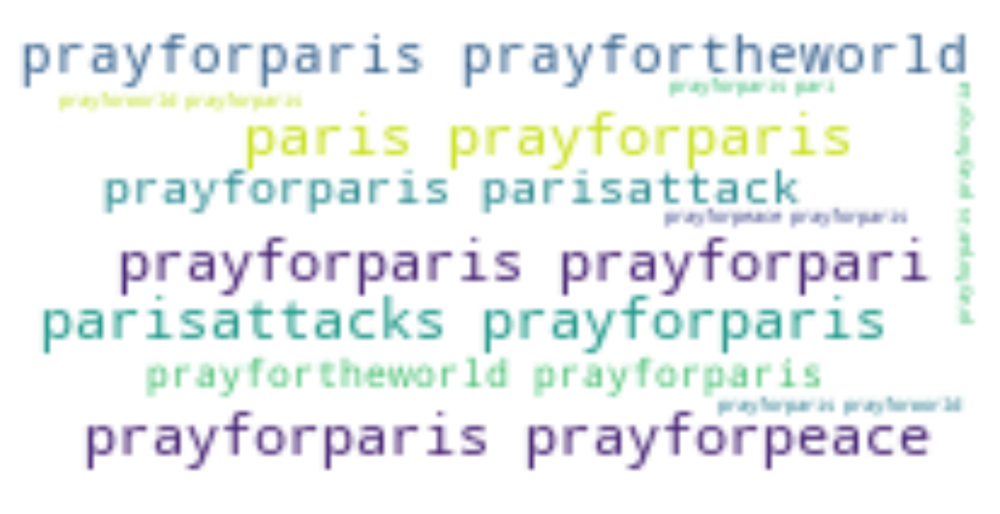

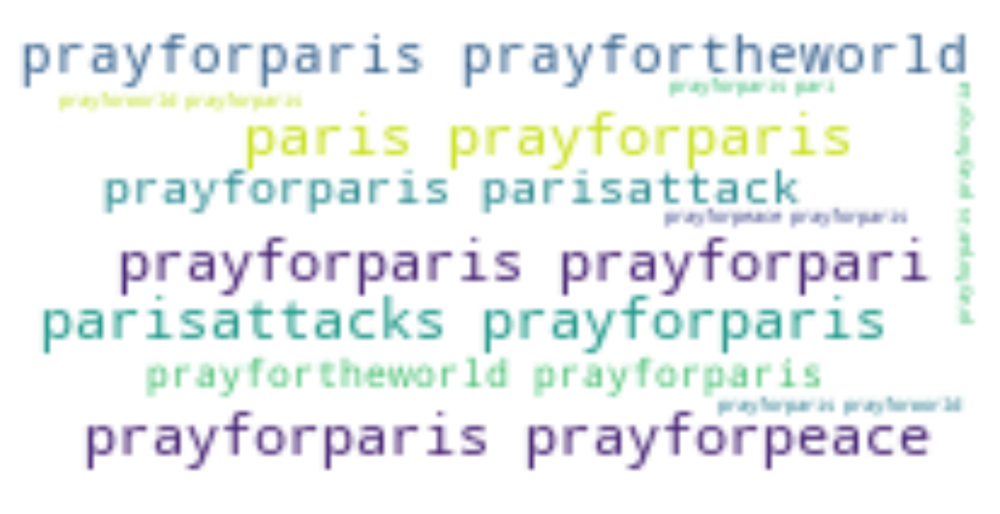

In [12]:
aaa = wordcloud(df_Paris['#PrayForParis']['hashtags'])
aaa #= wordcloud(df_Paris['#PrayForParis']['text'])

## Mapping the tweets

In [13]:
def get_coord(df):
    df = df.dropna(subset=['place_coordinates']).reset_index(drop=True)
    coord = []
    for i in range(len(df['place_coordinates'])):
        if( df['place_coordinates'][i]!='[' and df['place_coordinates'][i] !=']'):
            # print(test['place_coordinates'][i][0])
            coord.append(df['place_coordinates'][i].split(','))

    for i in range(len(coord)):
        for j in range(len(coord[i])):
            coord[i][j] = coord[i][j].replace('[',"")
            coord[i][j] = coord[i][j].replace(']',"")
            coord[i][j] = coord[i][j].replace(' ',"")

    #convert coord elements to float :
    for i in range(len(coord)):
        for j in range(len(coord[i])):
            coord[i][j] = float(coord[i][j])
    #keep index 0 and 1 :
    for i in range(len(coord)):
        coord[i] = coord[i][:2]
    return pd.DataFrame(coord,columns=['lon','lat'])

In [14]:


def multi_plot_tweets_spat(dfs):
    colors = px.colors.qualitative.Set1 # define a list of colors to use
    fig = go.Figure()

    for i,df in enumerate(dfs):
        if('place_coordinates' in dfs[df].columns):
            df_c = get_coord(dfs[df])
            
            trace = go.Scattermapbox(lat=df_c["lat"], lon=df_c["lon"], mode="markers", 
                                     marker=dict(color=colors[i%len(colors)], size=5, sizemode="diameter",
                                                              sizemin=4),
                                            name=f"{df}")
            fig.add_trace(trace)

    fig.update_layout(mapbox=dict(accesstoken = mapbox_access_token,
                                    center=go.layout.mapbox.Center(lat=48.8566, lon=2.3522), 
                                    zoom=1.))
    fig.update_layout(mapbox_style="carto-positron")
    fig.update_layout(legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.update_layout(coloraxis=dict(colorscale="reds", cmin=0, cmax=1, ))
    # fig.show(renderer="notebook")
    return fig

def Ratio_geo(dfs):
     for i,df in enumerate(dfs):
        if('place_coordinates' in dfs[df].columns):
            df_c = get_coord(dfs[df])

            print(f'{df}, sur {len(dfs[df])} tweets associés à ce #, {len(df_c)} sont géolocalisables.\t{round(len(df_c)*100/len(dfs[df]),1)}%')



In [15]:
a = multi_plot_tweets_spat(df_Paris)
a.show(renderer = "notebook")
Ratio_geo(df_Paris)

#13novembre2015, sur 50918 tweets associés à ce #, 3373 sont géolocalisables.	6.6%
#AttackParis, sur 1575 tweets associés à ce #, 103 sont géolocalisables.	6.5%
#Bataclan AND #13novembre2015, sur 5779 tweets associés à ce #, 430 sont géolocalisables.	7.4%
#parisattentats, sur 1913 tweets associés à ce #, 113 sont géolocalisables.	5.9%
#PrayForParis, sur 338548 tweets associés à ce #, 21351 sont géolocalisables.	6.3%
#proces13novembre, sur 13781 tweets associés à ce #, 124 sont géolocalisables.	0.9%
#StadeDeFrance AND #13novembre2015, sur 363 tweets associés à ce #, 42 sont géolocalisables.	11.6%
#terrasses AND #13novembre2015, sur 117 tweets associés à ce #, 8 sont géolocalisables.	6.8%
#UneBougiePourParis, sur 7356 tweets associés à ce #, 587 sont géolocalisables.	8.0%
#v13, sur 3580 tweets associés à ce #, 289 sont géolocalisables.	8.1%


## Histogramme des dates

In [16]:
def plot_hist_go(dfs):

    fig = go.Figure()
    
    for i,df in enumerate(dfs):
        trace = go.Histogram(x=dfs[df]['local_time'],
                        xbins=dict(
                            # start=df['local_time'].min(),
                            # end=df['local_time'].max(),
                            size='D1', # M18 stands for 18 months
                            ),
                        name=f"{df}",
                        autobinx=False
                        )
        fig.add_trace(trace)

    #set y axis on log scale :
    fig.update_layout(dragmode = 'pan')
    # fig.update_yaxes(type="log")
    return fig


In [17]:
plot_hist_go(df_Paris)

## Dash Code

In [18]:
app = JupyterDash(__name__)
app.layout = html.Div([
    html.H1("Tweets on Paris and Nice attacks"),
    #Plot table :
    html.Div([
        html.H3("Paris"),
        dash_table.DataTable(
            id='table',
            columns=[{"name": i, "id": i} for i in Desc_Paris.columns],
            data=Desc_Paris.to_dict('records'),
        ),
    ], style={'width': '49%', 'display': 'inline-block'}),
])


In [19]:
app = JupyterDash(__name__)

# app.layout = dash_table.DataTable(
    
#     data=Desc_Paris.to_dict('records'),
#     columns=[{'id': c, 'name': c} for c in Desc_Paris.columns]
# )
import plotly.express as px

app.layout = html.Div([
    html.H1("Tweets on Paris and Nice attacks"),
    html.Div([
        ############ Table Paris
        html.Div([
            html.H3("Paris"),
            dash_table.DataTable(
                id='table-paris',
                columns=[{"name": i, "id": i} for i in Desc_Paris.columns],
                data=Desc_Paris.to_dict('records'),
                style_cell = {
                    'textAlign':'center',
                    'minWidth':'0px', 'maxWidth':'70px',
                    'whiteSpace':'normal'
                }
            )
        ], style={'width': '45%', 'display': 'inline-block'}),
        ############ Table Nice
        html.Div([
            html.H3("Nice"),
            dash_table.DataTable(
                id='table-nice',
                columns=[{"name": i, "id": i} for i in Desc_Nice.columns],
                data=Desc_Nice.to_dict('records'),
                style_cell = {
                    'textAlign':'center',
                    'minWidth':'0px', 'maxWidth':'70px',
                    'whiteSpace':'normal'
                }
            )
        ], style={'width': '45%', 'display': 'inline-block', 'margin-left': '5px'})
        ]),
        ############ Histogram Paris
        html.Div([
        dcc.Graph(id='histogram_Paris',figure=plot_hist_go(df_Paris),
                config={'displayModeBar':True,'scrollZoom':True}, 
                style={'width': '49%', 'display': 'inline-block'}),
        dcc.RadioItems(
            id='scale_radio_Paris',
            options=[
                {'label': 'Linear', 'value': 'linear'},
                {'label': 'Log', 'value': 'log'}
            ],
            value='linear',
            labelStyle={'display': 'inline-block'}
        )
        ]),

        ############ Histogram Nice
        html.Div([
        dcc.Graph(id='histogram_Nice',figure=plot_hist_go(df_Nice),
                config={'displayModeBar':True,'scrollZoom':True}, 
                style={'width': '49%', 'display': 'inline-block'}),
        dcc.RadioItems(
            id='scale_radio_Nice',
            options=[
                {'label': 'Linear', 'value': 'linear'},
                {'label': 'Log', 'value': 'log'}
            ],
            value='linear',
            labelStyle={'display': 'inline-block'}
        )
        ]),

        ############ Map Paris
        html.Div([
        # change size :
        dcc.Graph(figure=multi_plot_tweets_spat(df_Paris),
                  config={'displayModeBar':True,'scrollZoom':True, 'responsive' : True}, 
                  style={'width':'49%'})
        ]),

        ############ Map Nice
        html.Div([
        # change size :
        dcc.Graph(figure=multi_plot_tweets_spat(df_Nice),
                  config={'displayModeBar':True,'scrollZoom':True, 'responsive' : True}, 
                  style={'width':'49%'})
        ])
])

In [20]:
from dash.dependencies import Input, Output

# Define your callback to update the graph
@app.callback(
    [Output('histogram_Paris', 'figure'),Output('histogram_Nice', 'figure')],
    [Input('scale_radio_Paris', 'value'),Input('scale_radio_Nice', 'value')]
)
def update_graph(scale_radio_Paris,scale_radio_Nice):
    fig1 = plot_hist_go(df_Paris)
    fig1.update_layout(yaxis_type=scale_radio_Paris)

    fig2 = plot_hist_go(df_Nice)
    fig2.update_layout(yaxis_type=scale_radio_Nice)
    return fig1,fig2


In [21]:
app.run_server(mode='external')

Dash is running on http://127.0.0.1:8050/

Dash app running on http://127.0.0.1:8050/


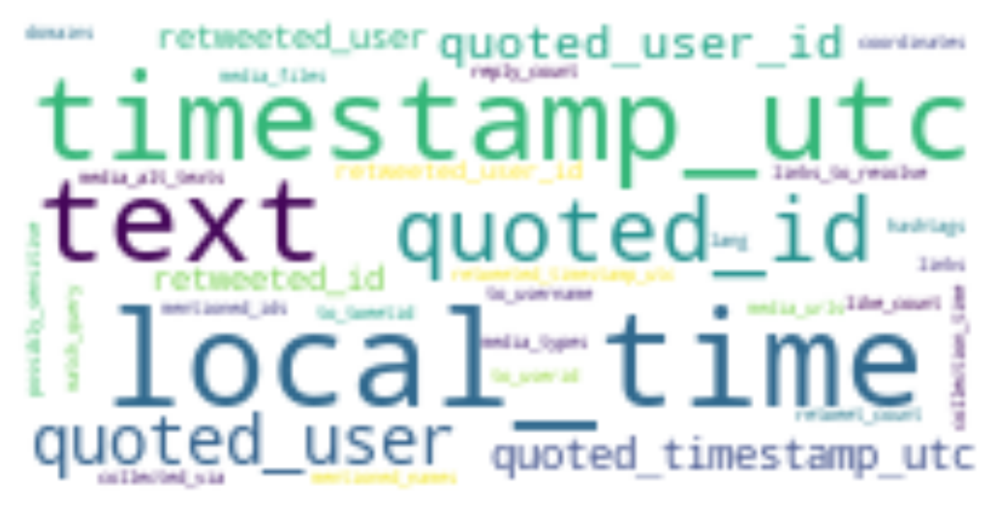

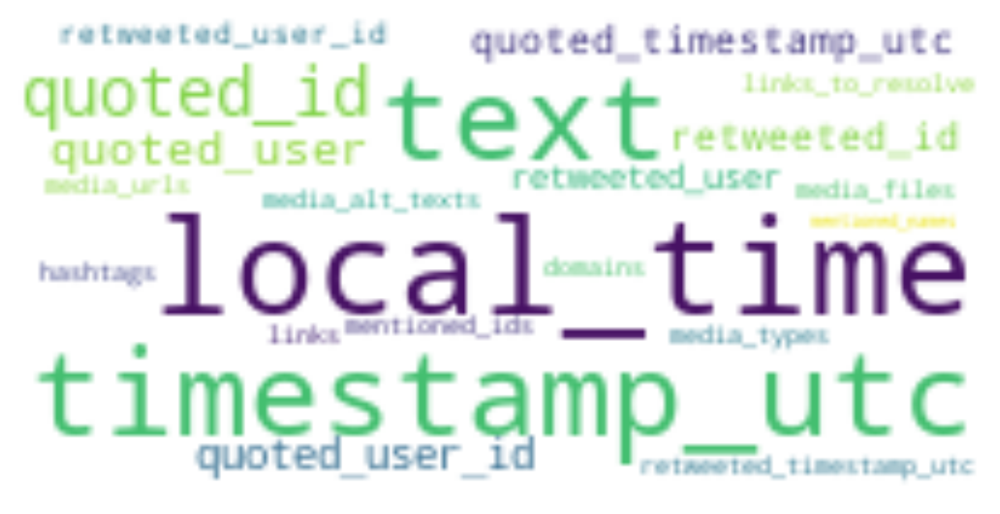

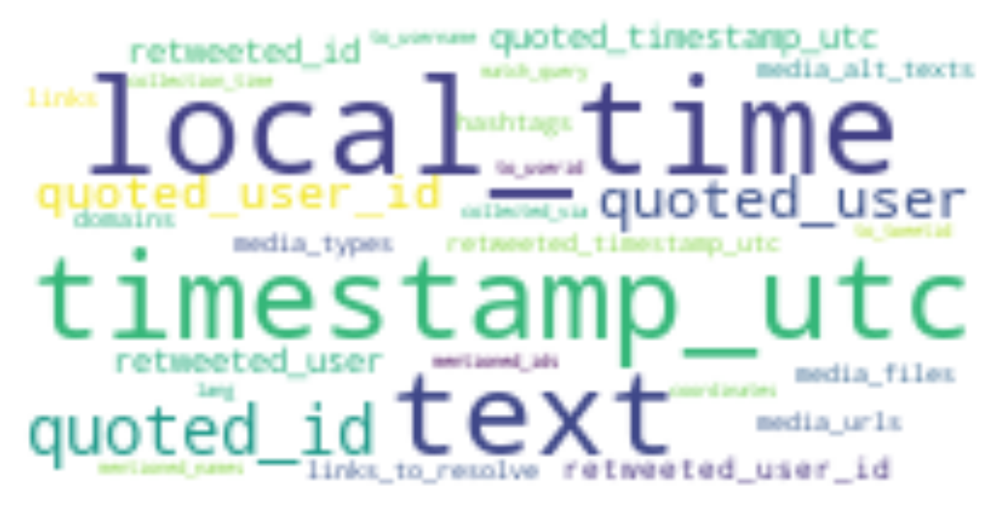

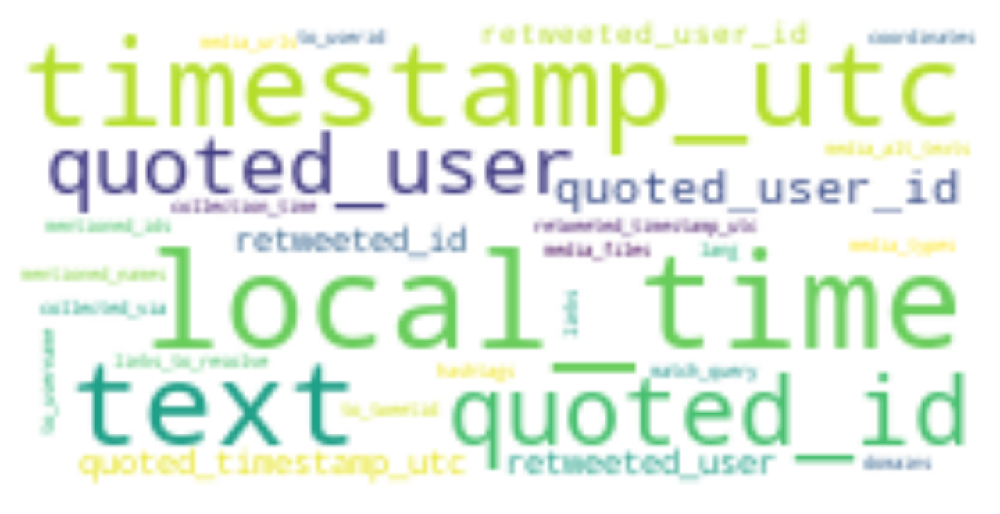

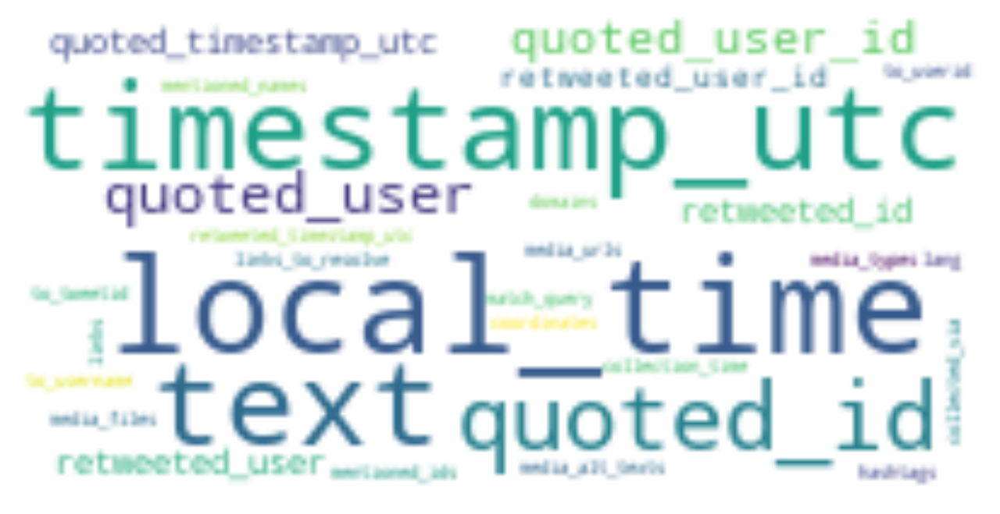

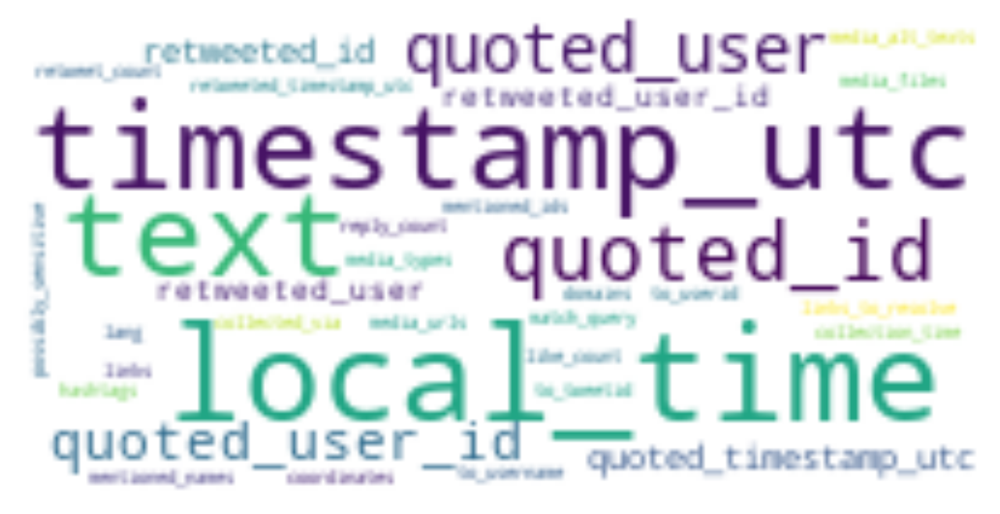

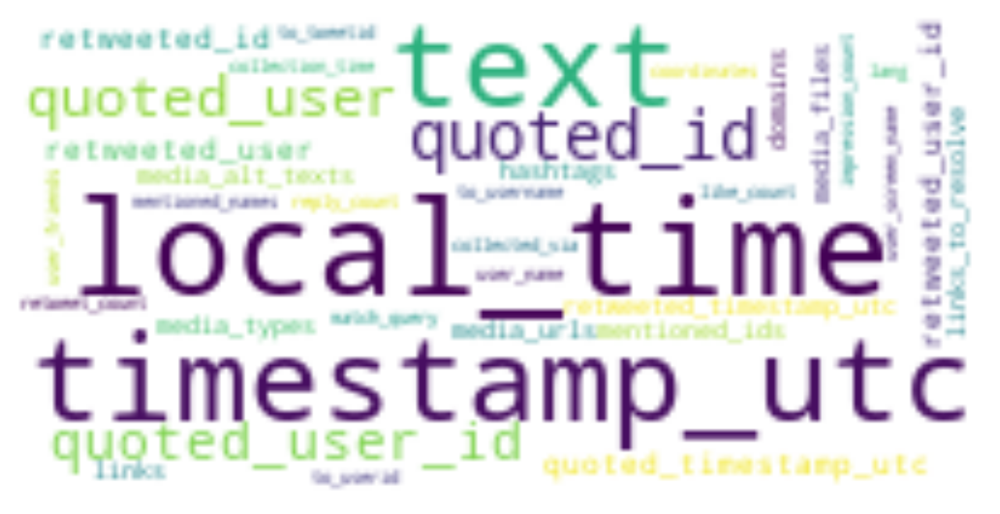

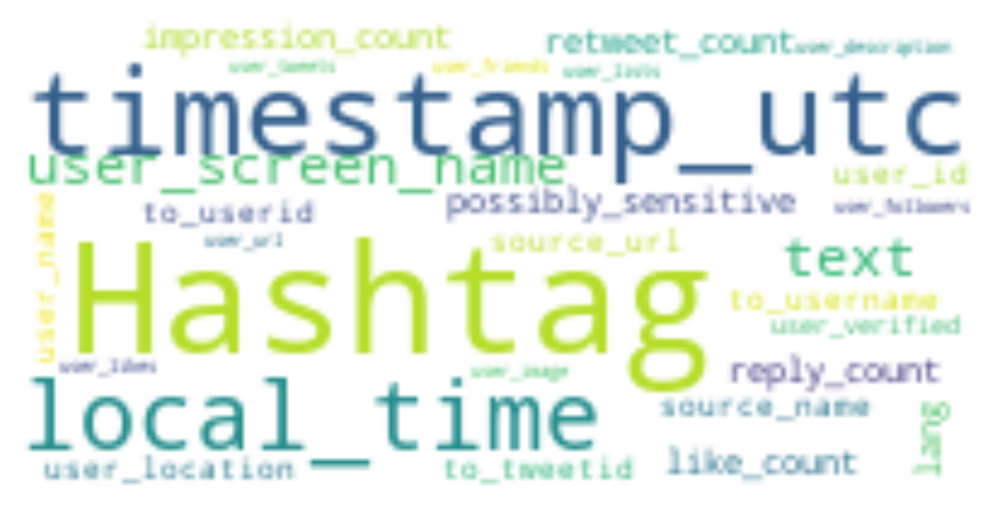

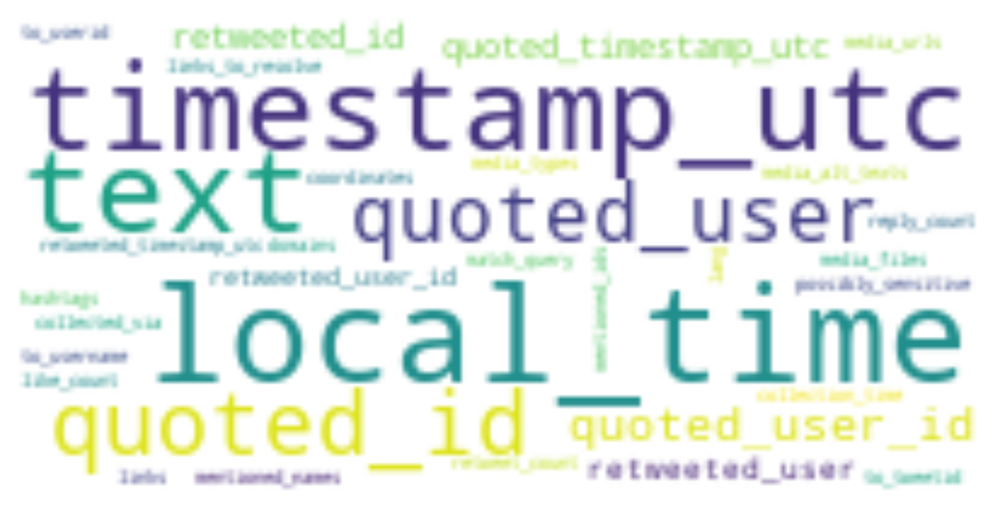

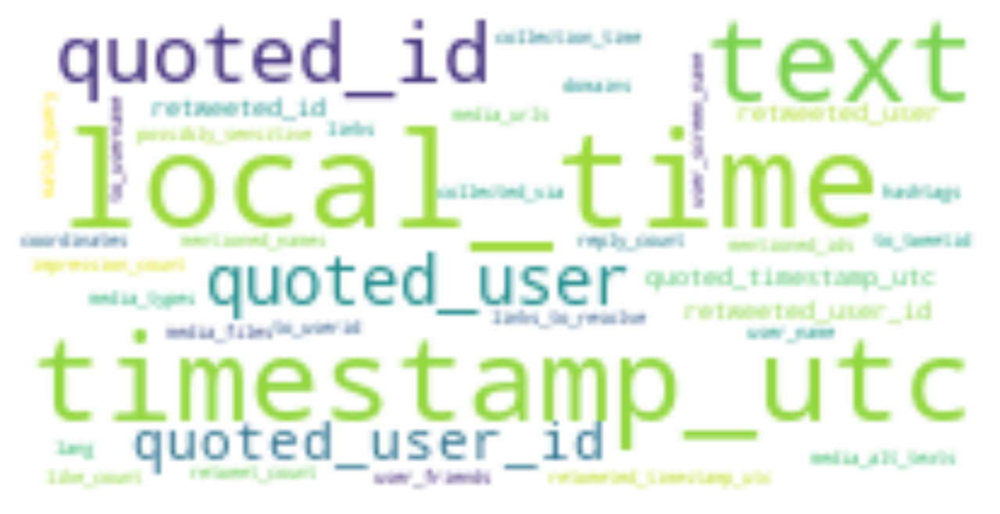

In [22]:
# Define a dictionary of strings and images
for k in range(len(list_Nice)):
    image_dict = {
        k:wordcloud(df_Nice[list_Nice[k]])
}

In [23]:
app.layout = html.Div([
    html.H1('Image Selector'),
    dcc.Dropdown(
        id='string-dropdown',
        options=[{'label': k, 'value': k} for k in image_dict.keys()],
        value='cat'
    ),
    html.Div(id='image-container')
])


In [24]:
# Define a callback function to update the image based on the dropdown selection
@app.callback(
    dash.dependencies.Output('image-container', 'children'),
    [dash.dependencies.Input('string-dropdown', 'value')])
def update_image(string):
    img = wordcloud(string)
    return html.Img(src=img, style={'width': '50%'})

In [25]:
app.run_server(mode='external')

Dash is running on http://127.0.0.1:8050/

Dash app running on http://127.0.0.1:8050/
